# Homework 5

## References

+ Lectures 17-20 (inclusive).


## Instructions

+ Type your name and email in the "Student details" section below.
+ Develop the code and generate the figures you need to solve the problems using this notebook.
+ For the answers that require a mathematical proof or derivation you should type them using latex. If you have never written latex before and you find it exceedingly difficult, we will likely accept handwritten solutions.
+ The total homework points are 100. Please note that the problems are not weighed equally.

In [ ]:
import numpy as np
np.set_printoptions(precision=3)
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set(rc={"figure.dpi":100, "savefig.dpi":300})
sns.set_context("notebook")
sns.set_style("ticks")

import scipy
import scipy.stats as st
import urllib.request
import os

def download(
    url : str,
    local_filename : str = None
):
    """Download a file from a url.

    Arguments
    url            -- The url we want to download.
    local_filename -- The filemame to write on. If not
                      specified
    """
    if local_filename is None:
        local_filename = os.path.basename(url)
    urllib.request.urlretrieve(url, local_filename)

## Student details

+ **First Name:**
+ **Last Name:**
+ **Email:**

# Problem 1 - Clustering Uber Pickup Data

In this problem you will analyze Uber pickup data collected during April 2014 around New York City.
The complete data are freely on [Kaggle](https://www.kaggle.com/fivethirtyeight/uber-pickups-in-new-york-city/).
The data consist of a timestamp (which we are going to ignore), the latitude and longitude of the Uber pickup, and a base code (which we are also ignoring).
The data file we are going to use is [uber-raw-data-apr14.csv](https://raw.githubusercontent.com/PredictiveScienceLab/data-analytics-se/master/homework/uber-raw-data-apr14.csv).
As usual, you have to make it visible to this Jupyter notebook.
On Google Colab, just run this:

In [ ]:
url = "https://github.com/PredictiveScienceLab/data-analytics-se/raw/master/lecturebook/data/uber-raw-data-apr14.csv"
download(url)

And you can load it using pandas:

In [ ]:
import pandas as pd
p1_data = pd.read_csv('uber-raw-data-apr14.csv')

Here is a text view:

In [ ]:
p1_data

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512
...,...,...,...,...
564511,4/30/2014 23:22:00,40.7640,-73.9744,B02764
564512,4/30/2014 23:26:00,40.7629,-73.9672,B02764
564513,4/30/2014 23:31:00,40.7443,-73.9889,B02764
564514,4/30/2014 23:32:00,40.6756,-73.9405,B02764


As you see, there where about half a million Uber pickups during April 2014...
Let's extract the lattitude and longitude data only (this is needed for passing them to scikit-learn algorithms).
Here is how you can do this in pandas:

In [ ]:
# Just use the column names as indices.
# The two brackets are required because you are actually
# passing a list of columns
loc_data = p1_data[['Lon', 'Lat']]
loc_data

,Lon,Lat
0,-73.9549,40.7690
1,-74.0345,40.7267
2,-73.9873,40.7316
3,-73.9776,40.7588
4,-73.9722,40.7594
...,...,...
564511,-73.9744,40.7640
564512,-73.9672,40.7629
564513,-73.9889,40.7443
564514,-73.9405,40.6756


Let's also visualize these points:

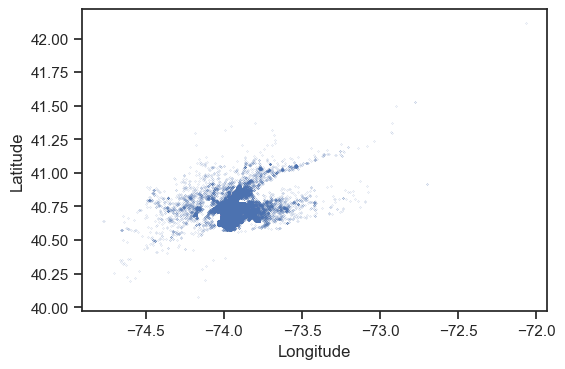

In [ ]:
fig, ax = plt.subplots()
ax.scatter(loc_data.Lon, loc_data.Lat, s=0.01)
# ``s=0.01`` specifies the size. I am using a small size because
# these are too many points to visualize
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude');

This is nice, but it would be even nicer if we had a map of New York City on the background.
We can make such a map on [www.openstreetmap.org](https://www.openstreetmap.org/export#map=11/40.7855/-73.8964).
We just need to have a box of longitude's and latitudes that overlaps with our data.
Here is how to get such a *bounding box*:

In [ ]:
box = ((loc_data.Lon.min(), loc_data.Lon.max(),
        loc_data.Lat.min(), loc_data.Lat.max()))
box

(-74.7733, -72.0666, 40.0729, 42.1166)

I have already extracted this picture for you and you can find it [here](https://github.com/PredictiveScienceLab/data-analytics-se/blob/master/homework/ny_map.png).
As always, it needs to be visible from the Jupyter notebook.
On Google Colab run:

In [ ]:
url = "https://github.com/PredictiveScienceLab/data-analytics-se/raw/master/lecturebook/images/ny_map.png"
download(url)

If you have it at the right place, you should be able to see the image here:
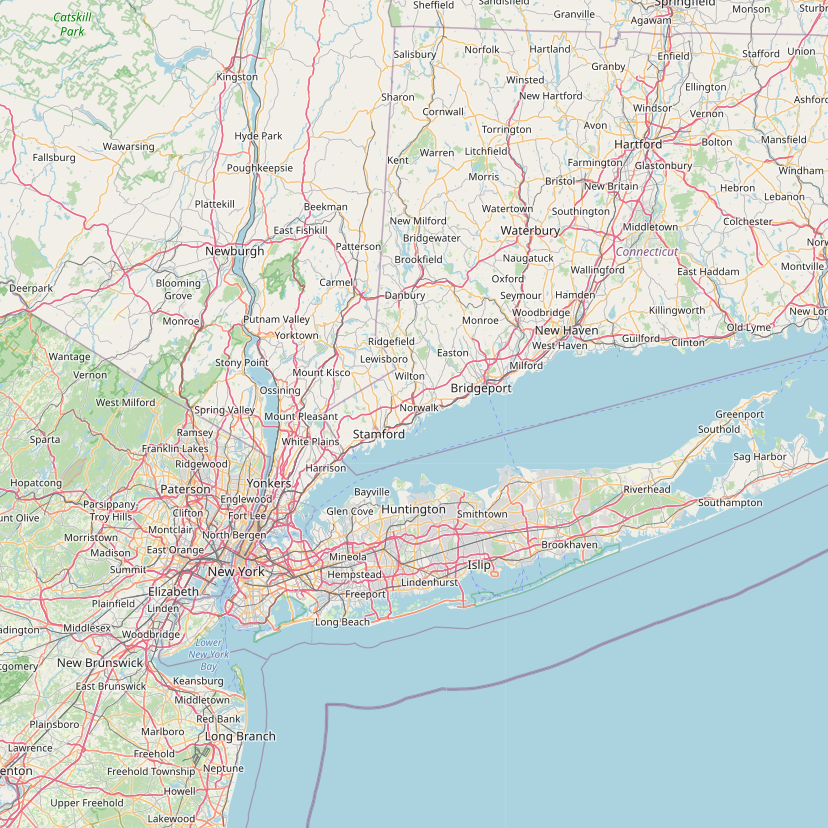
![New York City Map](https://github.com/PredictiveScienceLab/data-analytics-se/blob/master/lecturebook/homework/ny_map.png?raw=1)

Now let's load the image as a matrix:

In [ ]:
ny_map = plt.imread('ny_map.png')

And we can visualize it with ``plt.imshow`` and draw the Uber pickups on top of it.
Here is how:

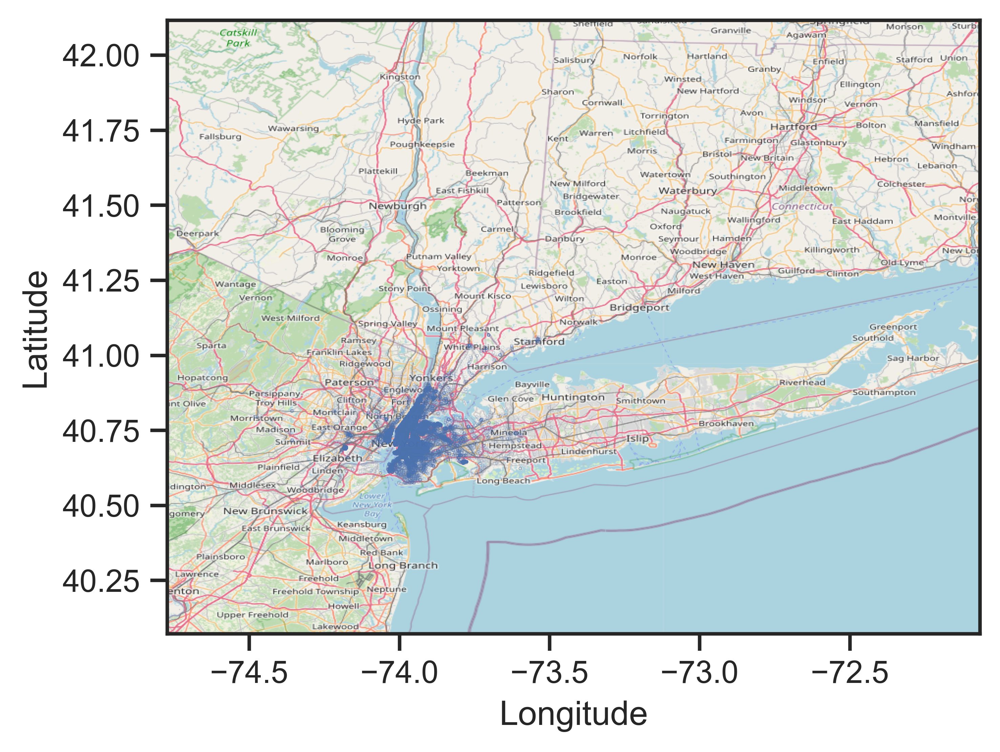

In [ ]:
fig, ax = plt.subplots(dpi=600)
ax.scatter(
    loc_data.Lon,
    loc_data.Lat,
    zorder=1,
    alpha= 0.5,
    c='b',
    s=0.001
)
ax.set_xlim(box[0],box[1])
ax.set_ylim(box[2],box[3])
ax.imshow(
    ny_map,
    zorder=0,
    extent=box,
    aspect= 'equal'
)
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude');

Because we have over half a million data points, machine learning algorithms may be a bit slow.
So, as you develop your code use use only 50K observations.
Once you have a stable version of your code, modify the following code segment to make use of the entire dataset.

In [ ]:
# While your are developing your code use this:
p1_train_data = loc_data[:100000]
# When you have a stable code, use this:
# p1_train_data = loc_data

## Part A - Splitting New York City into Subregions

Suppose that you are assigned the task of splitting New York City into operating subregions with pretty much equal demand.
When a pickup is requested in each subregion only the drivers in that region are called.
Note that this can quickly become a very difficult problem very quickly.
We are not looking for the best possible answer here.
This would require posing and solving a suitable optimization problem.
We are looking for a data-informed solution that is compatible with common sense.

Do (at least) the following:
+ Use Kmeans clustering on the pickup data with different number of clusters;
+ Visualize the labels of the clusters on the map using different colors (see the hands-on activities);
+ Visualize the centers of the discovered Kmeans clusters (in red color);
+ Use your common sense, e.g., make sure that you have enough clusters so that no region crosses the water (even if it is possible the drivers may have to pay tolls to cross). If it is impossible to get perfect results simply by Kmeans, feel free to ignore a small number of outliers as they could be handled manually;
+ Use [MiniBatchKMeans](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.MiniBatchKMeans.html#sklearn.cluster.MiniBatchKMeans) which is an much faster version of Kmeans suitable for large datasets (>10K observations);

Answer with as many text blocks and code blocks as you like right below.

I picked 20 clusters because this seems to decompose the NYC area into nice segments that doesn’t
require paying tolls may times. Of course, note that KMeans may give slightly different results
every time you run it.

In [ ]:
from sklearn.cluster import MiniBatchKMeans
kmeans = MiniBatchKMeans(n_clusters=20, batch_size=10)
model = kmeans.fit(p1_train_data)

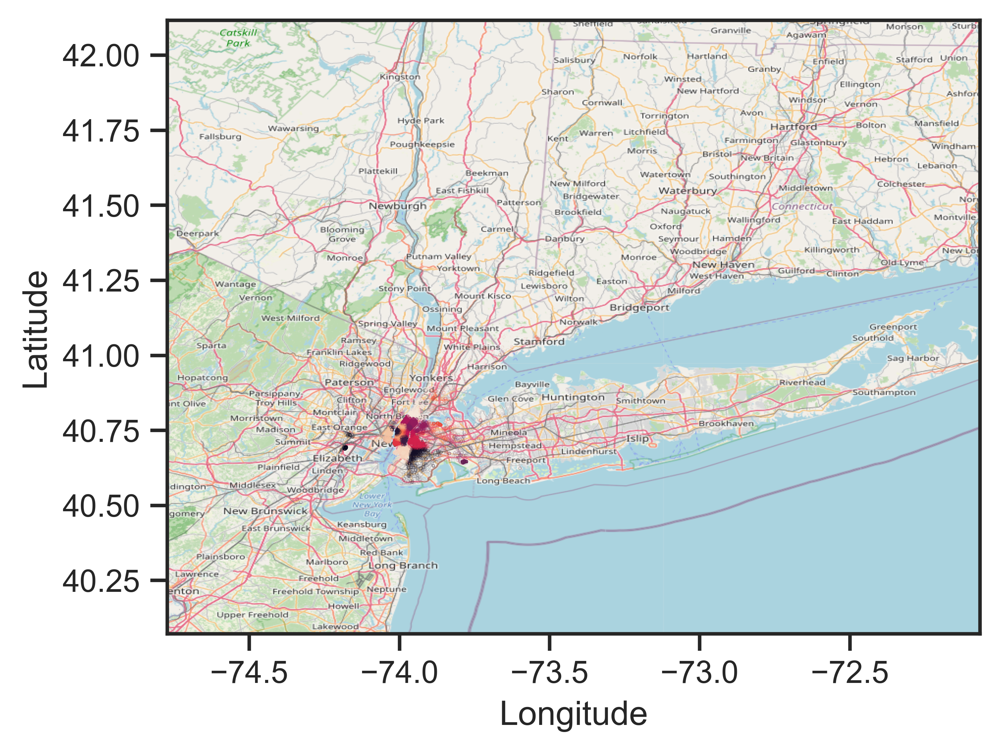

In [ ]:
fig, ax = plt.subplots(dpi=600)
labels = model.predict(p1_train_data)
ax.scatter(p1_train_data.Lon, p1_train_data.Lat, zorder=1, alpha= 0.5,
           c=labels, s=0.001)
ax.scatter(model.cluster_centers_[:, 1], model.cluster_centers_[:, 0],
           zorder=2, color='red', s=1)
ax.set_xlim(box[0],box[1])
ax.set_ylim(box[2],box[3])
ax.imshow(ny_map, zorder=0, extent=box, aspect= 'equal')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude');

## Part B - Create a Stochastic Model of Pickups

One of the key ingredients for a more sophisticated approach to optimizing the operations of Uber would involve the construction of a stochastic model of the demand for pickups.
The ideal model for this problem is the [Poisson Point Process](https://en.wikipedia.org/wiki/Poisson_point_process).
However, we are going to do something simpler, using the Gaussian mixture model and a Poisson random variable.
The model will not have a time component, but it will allow us to sample the number and locations of pickups during a typical month.
We will guide you through the process of constructing this model.

### Subpart B.I - Random variable capturing number of monthly pickups

Find the rate of monthly pickups (ignore the fact that months may differ by a few days) and use it to define a Poisson random variable corresponding to the monthly number of pickups.
Use ``scipy.stats.poisson`` to initialize this random variable. Sample from it 10,000 times and plot the histogram of the samples to get a feeling about the corresponding probability mass function.

In [ ]:
p1_train_data.shape[0]

100000

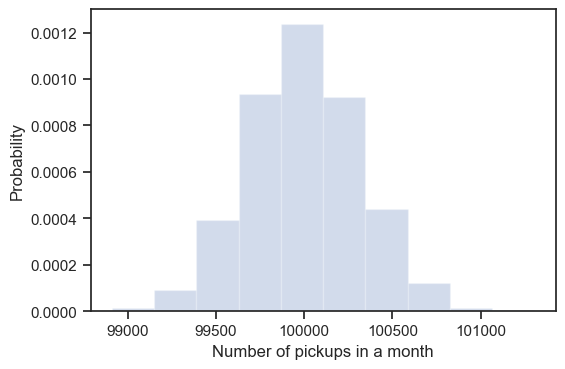

In [ ]:
# We will pick the rate to be the number of pickups in April.
# That's the best we can do with the info we have
pickup_rate = p1_train_data.shape[0]
# Here is the poisson random variable for the pickups
pickup_number_model = st.poisson(pickup_rate)
# And here is the requested histogram
zs = pickup_number_model.rvs(10000)
fig, ax = plt.subplots(dpi=100)
ax.hist(zs, density=True, alpha=0.25)
ax.set_xlabel('Number of pickups in a month')
ax.set_ylabel('Probability');

### Subpart B.II - Estimate the spatial density of pickups

Fit a Gaussian Mixture model to the pickup data.
**Do not use the Bayesian Information Criterion** to decide how many components to keep.
This would take quite a bit of time for this problem. Simply use 40 mixture components.
Plot the contour of the logarithm of the probability density on the New York City map.

In [ ]:
from sklearn.mixture import GaussianMixture
pickup_density_model = GaussianMixture(n_components=40).fit(p1_train_data)

/Users/tiikuo/miniforge3/lib/python3.9/site-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but GaussianMixture was fitted with feature names
  warnings.warn(


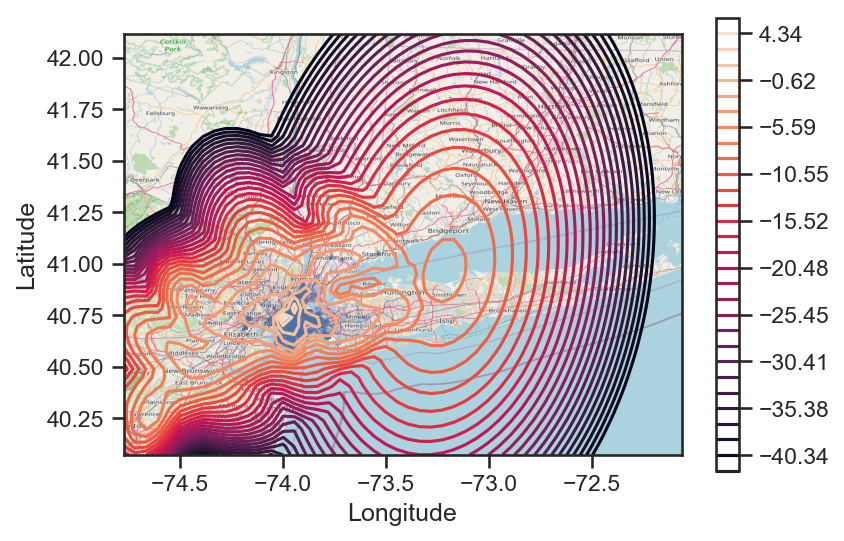

In [ ]:
x = np.linspace(box[0], box[1])
y = np.linspace(box[2],box[3])
X, Y = np.meshgrid(x, y)
XX = np.array([X.ravel(), Y.ravel()]).T
Z = pickup_density_model.score_samples(XX)
Z = Z.reshape(X.shape)
fig, ax = plt.subplots(dpi=150)
ax.set_xlim(box[0], box[1])
ax.set_ylim(box[2], box[3])
ax.imshow(ny_map, zorder=0, extent=box, aspect= 'equal')
ax.scatter(loc_data.Lon, loc_data.Lat, zorder=1, alpha= 0.5, c='b', s=0.001)
c = ax.contour(X, Y, Z, levels=np.linspace(-42, 6, 30))
plt.colorbar(c)
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude');

### Subpart B.III - Sample some random months of pickups

Now that you have a model that gives you the number of pickups and a model that allows you to sample a pickup location, sample five different datasets (number of pickups and location of each pick) from the combined model and visualize them on the New York map.

**Hint:** Don't get obsessed with making the model perfect. It's okay if a few of the pickups are on water...

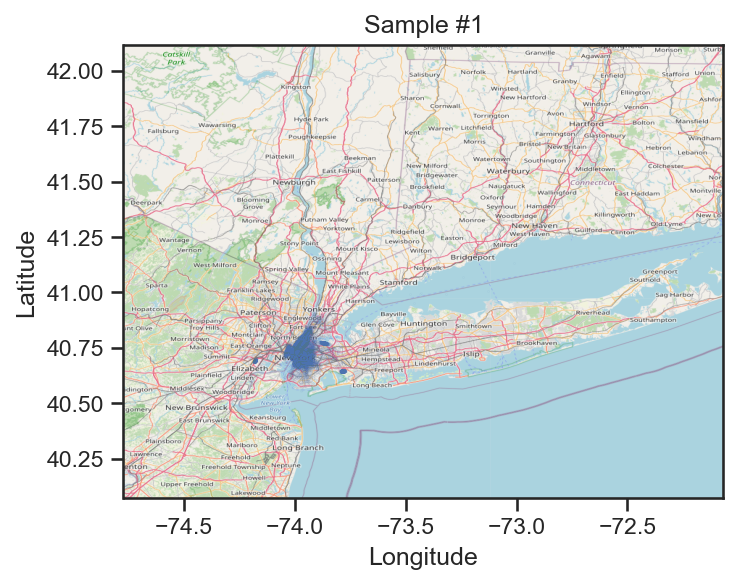

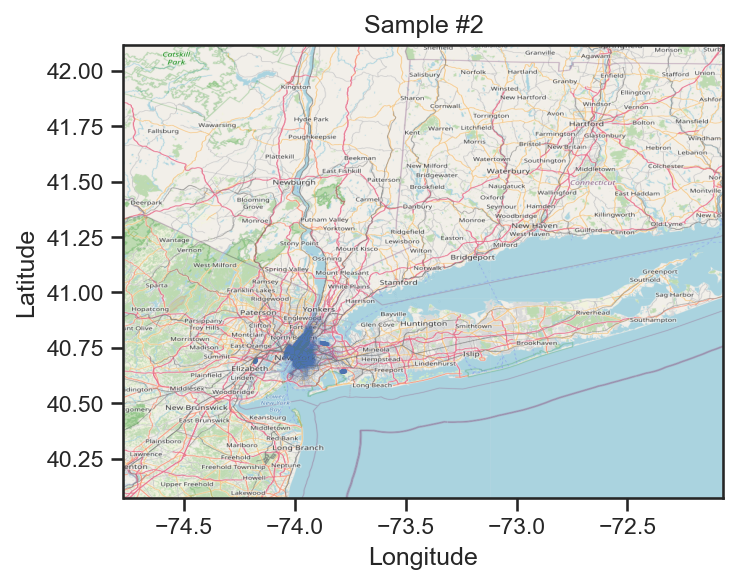

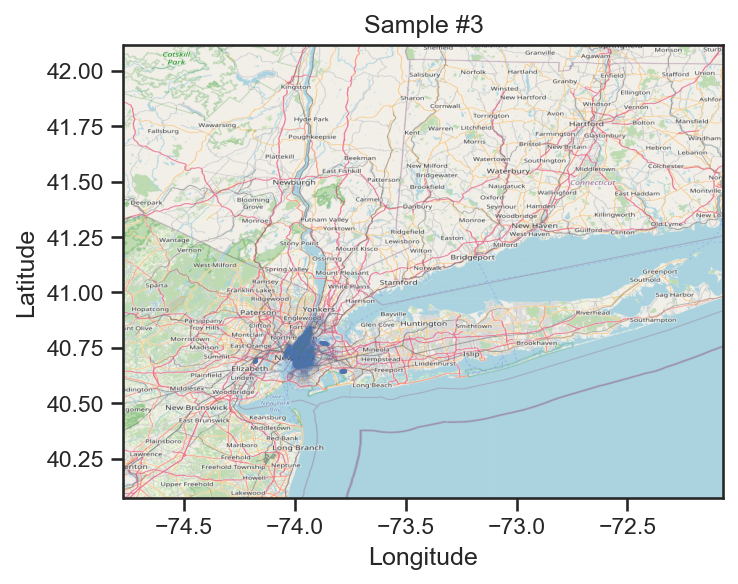

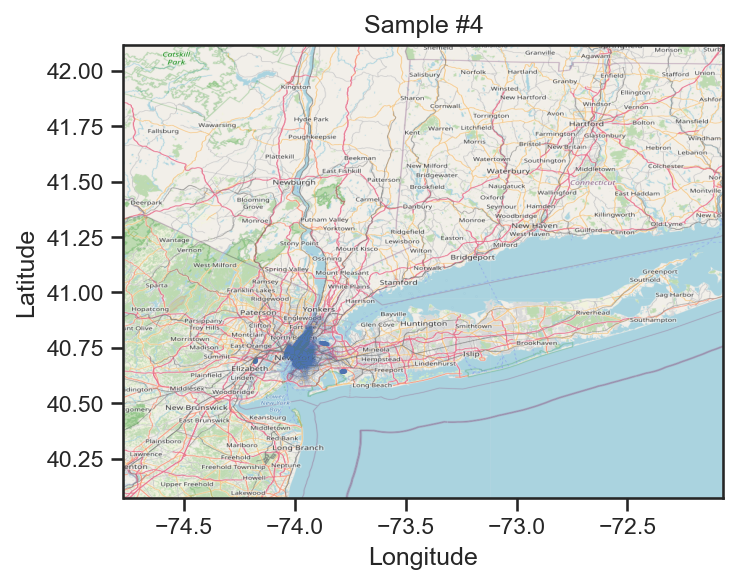

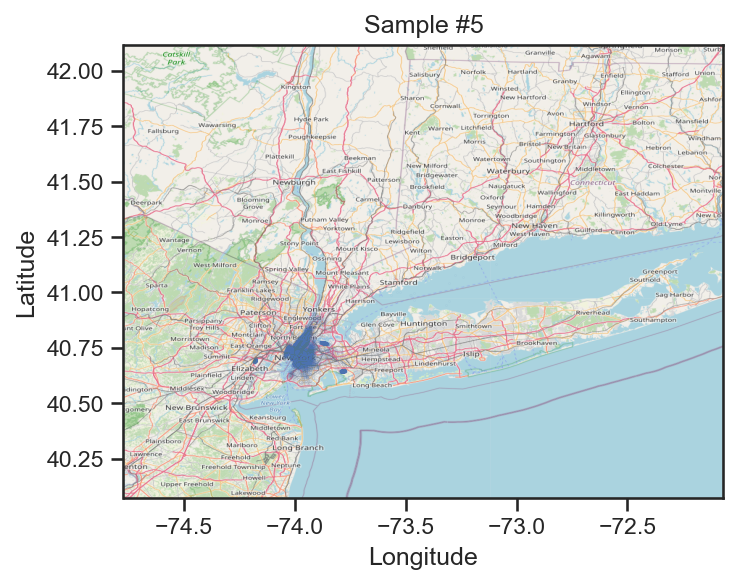

In [ ]:
for s in range(5):

# sample the number of pickups
  z = pickup_number_model.rvs()
# now sample the pick up locations from the Gaussian mixture model
  locs = pickup_density_model.sample(z)[0]
# Plot this sample on NYC map
  fig, ax = plt.subplots(dpi=150)
  ax.set_xlim(box[0], box[1])
  ax.set_ylim(box[2], box[3])
  ax.imshow(ny_map, zorder=0, extent=box, aspect= 'equal')
  ax.scatter(locs[:, 0], locs[:, 1], zorder=1, alpha= 0.5, c='b', s=0.001)
  ax.set_xlabel('Longitude')
  ax.set_ylabel('Latitude')
  ax.set_title('Sample #{0:d}'.format(s+1));

# Problem 2 - Counting Celestial Objects

Consider [this picture](https://github.com/PredictiveScienceLab/data-analytics-se/raw/master/datasets/galaxies.png) of a patch of sky taken by the [Hubble Space Telescope](https://www.nasa.gov/mission_pages/hubble/story/index.html):

In [ ]:
url = 'https://github.com/PredictiveScienceLab/data-analytics-se/blob/master/lecturebook/images/galaxies.png?raw=true'
download(url)

[Galaxies](https://github.com/PredictiveScienceLab/data-analytics-se/blob/master/lecturebook/images/galaxies.png?raw=true)
![galaxies](https://github.com/PredictiveScienceLab/data-analytics-se/blob/master/lecturebook/images/galaxies.png?raw=true)

This picture includes many galaxies, but also some starts.
We are going to create a machine learning model capable of counting the number of objects in such images.
Our model is not going to be able to differentiate between the different types of objects, and it will not be very accurate, but it does form the basis of more sophisticated approaches.
The idea is as follows:
+ Convert the picture to points sampled according to the intensity of light.
+ Apply Gaussian mixture on the resulting points.
+ Use the Bayesian Information Criterion to identify the number of components in the picture.
+ Associate the number of components with the actual number of celestial objects.

I will set you up with the first step. You will have to do the last three.

We are going to load the image with the [Python Imaging Library (PIL)](https://en.wikipedia.org/wiki/Python_Imaging_Library) which allows us to apply a few basic transformations to the image:

In [ ]:
url = 'https://raw.githubusercontent.com/PredictiveScienceLab/data-analytics-se/master/lecturebook/images/galaxies.png'
download(url)

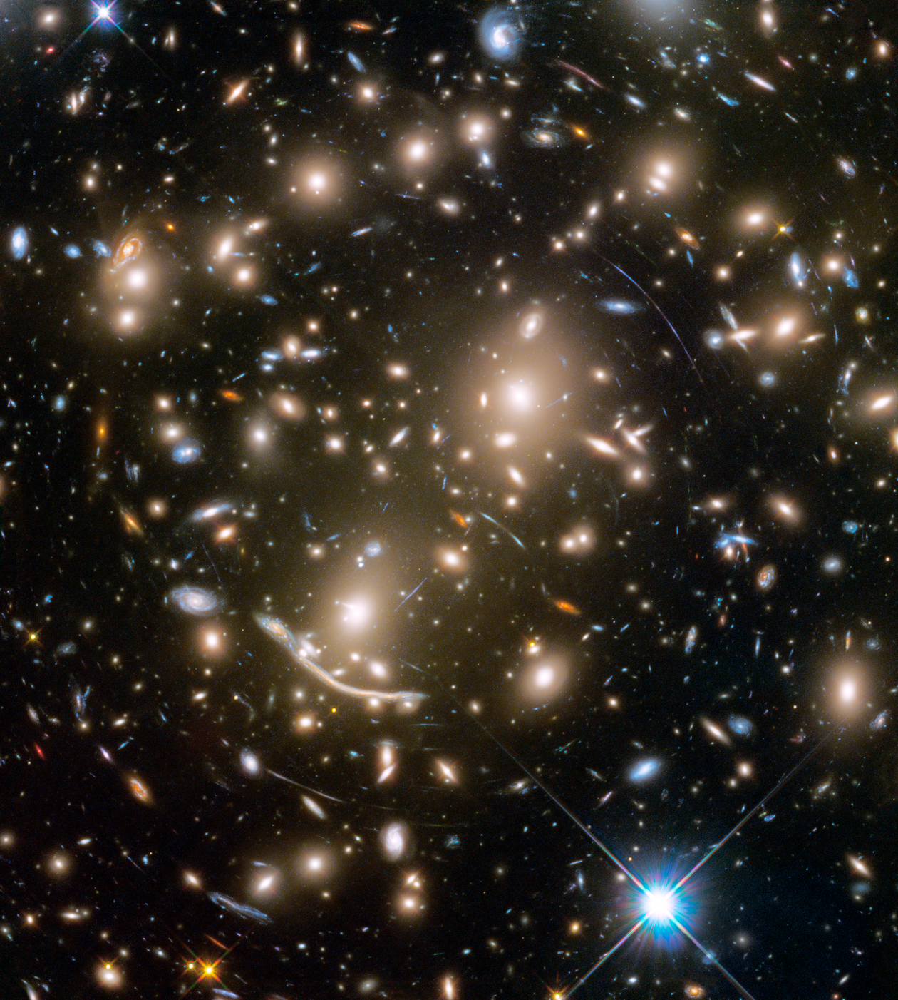

In [ ]:
from PIL import Image
hubble_image = Image.open('galaxies.png')
# here is how to see the image
hubble_image

Now we are going to convert it to gray scale and crop it to make the problem a little bit easier:

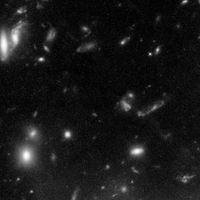

In [ ]:
img = hubble_image.convert('L').crop((100, 100, 300, 300))
img

Remember that black-and white images are matrices:

In [ ]:
img_ar = np.array(img)
img_ar

array([[ 7, 11, 11, ..., 28, 62, 88],
       [12, 12, 11, ..., 29, 47, 86],
       [18, 13, 11, ..., 24, 34, 87],
       ...,
       [24, 12, 15, ..., 43, 47, 40],
       [23, 12, 19, ..., 48, 49, 40],
       [18, 18, 23, ..., 50, 49, 41]], dtype=uint8)

The minimum number if $0$ corresponding to black and the maximum number is 255 corresponding to white.
Anything in between is some shade of gray.

Now, imagine that each pixel is associated with some cordinates.
Without loss of generality, let's assume that each pixel is some coordinate in $[0,1]^2$.
We will loop over each of the pixels and sample its coordinates in a way that increases with increasing light intensity.
To achieve this, we will pass the intensity values of each pixels through a sigmoid with parameters that can be tuned.
Here is this sigmoid:

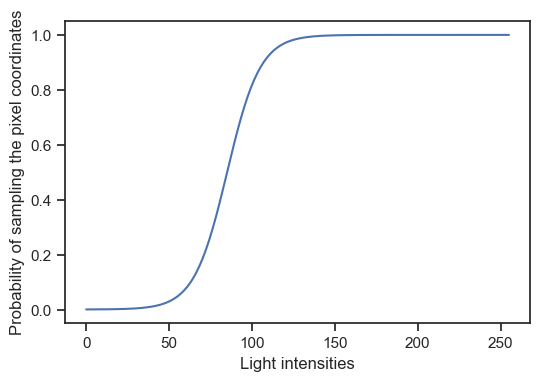

In [ ]:
intensities = np.linspace(0, 255, 255)
fig, ax = plt.subplots()
alpha = 0.1
beta = 255 / 3
ax.plot(
    intensities,
    1.0 / (1.0 + np.exp(-alpha * (intensities - beta)))
);
ax.set_xlabel('Light intensities')
ax.set_ylabel('Probability of sampling the pixel coordinates');

And here is the code that samples the pixel coordinates.
I am organizing it into a function because we may want to use it with different pictures:

In [ ]:
def sample_pixel_coords(img, alpha, beta):
    """
    Samples pixel coordinates based on a probability defined as the sigmoid of the intensity.

    Arguments:

        img    -     The gray scale pixture from which we sample as an array
        alpha     -     The scale of the sigmoid
        beta      -     The offset of the sigmoid
    """
    img_ar = np.array(img)
    x = np.linspace(0, 1, img_ar.shape[0])
    y = np.linspace(0, 1, img_ar.shape[1])
    X, Y = np.meshgrid(x, y)
    img_to_locs = []
    # Loop over pixels
    for i in range(img_ar.shape[1]):
        for j in range(img_ar.shape[0]):
            # Calculate the probability of the pixel by looking at each
            # light intensity
            prob = 1.0 / (1.0 + np.exp(-alpha * (img_ar[j, i] - beta)))
            # Pick a uniform random number
            u = np.random.rand()
            # If u is smaller than the desired probability,
            # the consider the coordinates of the pixel sampled
            if u <= prob:
                img_to_locs.append((Y[i, j], X[-i-1, -j-1]))
    # Turn img_to_locs into a numpy array
    img_to_locs = np.array(img_to_locs)
    return img_to_locs

Let's test the code:

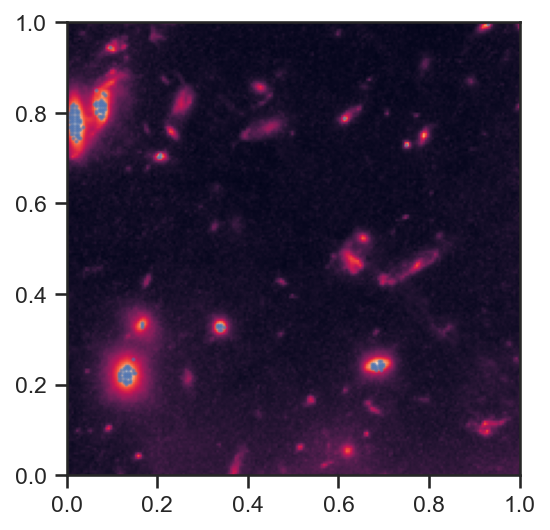

In [ ]:
locs = sample_pixel_coords(img, alpha=0.1, beta=200)
fig, ax = plt.subplots(dpi=150)
ax.imshow(img, extent=((0, 1, 0, 1)), zorder=0)
ax.scatter(
    locs[:, 0],
    locs[:, 1],
    zorder=1,
    alpha=0.5,
    c='b',
    s=1
);

Note that by playing with $\alpha$ and $\beta$ you can make the whole thing more or less sensitive to the light intensity.

In [ ]:
from sklearn.mixture import GaussianMixture

def count_objs(img, alpha, beta, nc_min=1, nc_max=50):
    """Count objects in image.

    Arguments:
        img       -     The image
        alpha     -     The scale of the sigmoid
        beta      -     The offset of the sigmoid
        nc_min    -     The minimum number of components to consider
        nc_max    -     The maximum number of components to consider
    """
    locs = sample_pixel_coords(img, alpha, beta)
    # **** YOUR CODE HERE ****
    # Use BIC to search for the best GaussianMixture model
    # with components between nc_min and nc_max
    # YOU CAN PULL THIS OFF BY COPY-PASTING MATERIAL FROM
    # LECTURE 17
    # Set the following variables
    best_nc = -1
    best_bic = 1e99
    best_model = None
    bics =[]
    for ncomp in range(nc_min, nc_max):
      model = GaussianMixture(n_components=ncomp).fit(locs)
      bic = model.bic(locs)
      if bic <= best_bic:
        best_model = model
        best_nc = ncomp
        best_bic = bic
    return best_nc, best_model, locs

Once you have completed the code, try it out the following images.
Feel free to play with $\alpha$ and $\beta$ to improve the performance.
**Do not try to make a perfect model. To do so, we would have to go beyond the Gaussian mixture model. This is just a homework problem.**

Here is a helper function for visualizing what you get:

In [ ]:
def visualize_counts(img, objs, model, locs):
    """Visualize the counts.

    Arguments
    img    --  The image.
    objs   --  Returned by count_objs()
    model  --  Returned by count_objs()
    locs   --  Returned by count_objs()
    """
    fig, ax = plt.subplots(dpi=150)
    ax.imshow(img, extent=((0, 1, 0, 1)))
    for i in range(model.means_.shape[0]):
        ax.plot(
            model.means_[i, 0],
            model.means_[i, 1],
            'rx',
            markersize=(
                10.0 * model.weights_.shape[0]
                * model.weights_[i]
            )
        )
    ax.scatter(
        locs[:, 0],
        locs[:, 1],
        zorder=1,
        alpha=0.5,
        c='b',
        s=1
    )
    ax.set_title('Counted {0:d} objects!'.format(objs));

Here is how to use the code:

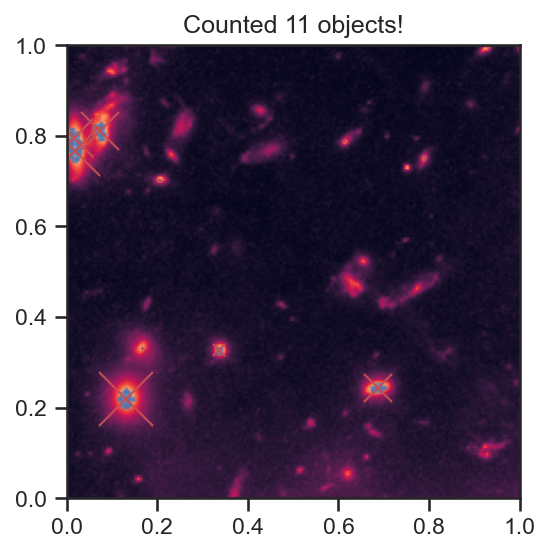

In [ ]:
objs, model, locs = count_objs(img, alpha=1.0, beta=200)
visualize_counts(img, objs, model, locs)

Try this one:

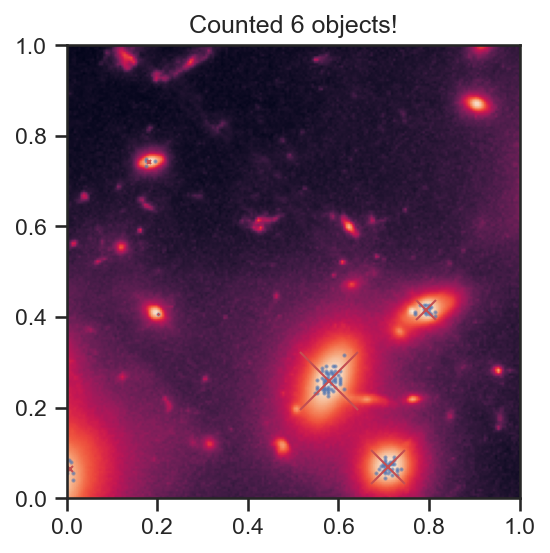

In [ ]:
img = hubble_image.convert('L').crop((200, 200, 400, 400))
objs, model, locs = count_objs(img, alpha=.1, beta=250)
visualize_counts(img, objs, model, locs)

And try this one:

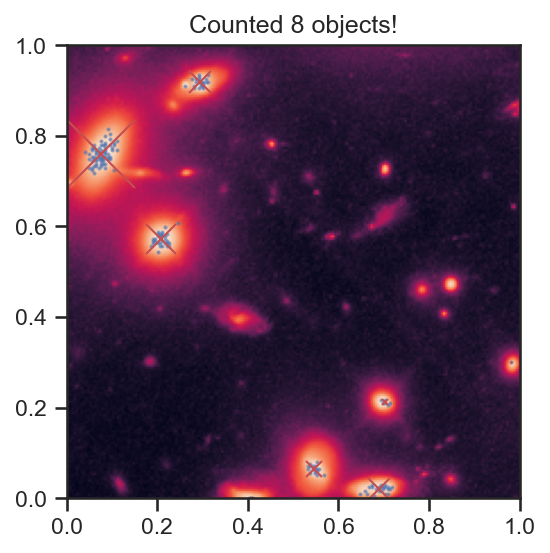

In [ ]:
img = hubble_image.convert('L').crop((300, 300, 500, 500))
objs, model, locs = count_objs(img, alpha=.1, beta=250)
visualize_counts(img, objs, model, locs)